In [1]:
import os
os.environ["CUDA_DEVICE_ORDER"] = "PCI_BUS_ID"
os.environ["CUDA_VISIBLE_DEVICES"] = "0"
import cv2
import pandas as pd
import numpy as np

from typing import List, Union
from joblib import Parallel, delayed

import timm
import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader, ConcatDataset
from torchvision.models import resnet50
import segmentation_models_pytorch as smp
import matplotlib.pyplot as plt

from tqdm import tqdm
import albumentations as A
from albumentations.pytorch import ToTensorV2
import random

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f"Using GPU is CUDA:{os.environ['CUDA_VISIBLE_DEVICES']}")
print('Device:', device)
print('Current cuda device:', torch.cuda.current_device())
print('Count of using GPUs:', torch.cuda.device_count())

seed = 57
random.seed(seed)
torch.manual_seed(seed)
torch.cuda.manual_seed(seed)
torch.cuda.manual_seed_all(seed)

torch.backends.cudnn.deterministic=True
torch.backends.cudnn.bechmark=False

np.random.seed(seed)


Using GPU is CUDA:0
Device: cuda
Current cuda device: 0
Count of using GPUs: 1


# Utills

In [2]:
# RLE 디코딩 함수
def rle_decode(mask_rle, shape):
    if mask_rle == -1:
        return np.zeros(shape, dtype=np.uint8)
    s = mask_rle.split()
    starts, lengths = [np.asarray(x, dtype=int) for x in (s[0:][::2], s[1:][::2])]
    starts -= 1
    ends = starts + lengths
    img = np.zeros(shape[0]*shape[1], dtype=np.uint8)
    for lo, hi in zip(starts, ends):
        img[lo:hi] = 1
    return img.reshape(shape)

# RLE 인코딩 함수
def rle_encode(mask):
    pixels = mask.flatten()
    pixels = np.concatenate([[0], pixels, [0]])
    runs = np.where(pixels[1:] != pixels[:-1])[0] + 1
    runs[1::2] -= runs[::2]
    return ' '.join(str(x) for x in runs)

# Custom Dataset

In [3]:
class SatelliteDataset(Dataset):
    def __init__(self, csv_file, transform=None, infer=False):
        self.data = pd.read_csv(csv_file)
        self.transform = transform
        self.infer = infer
        print("full dataset size : ",len(self.data))
    def __len__(self):
        return len(self.data)

    def __getitem__(self, idx):
        #img_path = self.data.iloc[idx, 1]    # default : ./train_img/TRAIN_0000.png
        img_path = "../data"+self.data.iloc[idx, 1][1:]
        image = cv2.imread(img_path)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        
        if self.infer:
            if self.transform:
                image = self.transform(image=image)['image']
            return image

        mask_rle = self.data.iloc[idx, 2]
        mask = rle_decode(mask_rle, (image.shape[0], image.shape[1]))

        if self.transform:
            augmented = self.transform(image=image, mask=mask)
            image = augmented['image']
            mask = augmented['mask']

        return image, mask

In [4]:
'''class TV_SatelliteDataset(Dataset):
    def __init__(self, csv_file, transform=None, is_train = True, stride=200):
        self.is_train = is_train
        self.transform = transform
        self.stride = stride
        self.size = 224
        self.cutter = int(7140*0.9) #tv cutter

        if self.is_train:
            self.data = pd.read_csv(csv_file)[:self.cutter]
        else:
            self.data = pd.read_csv(csv_file)[self.cutter:]

        self.images = []
        self.masks = []

        self.preprocess_images()

        print("Full dataset size:", len(self.images))

    def __len__(self):
        return len(self.images)

    def __getitem__(self, idx):
        image = self.images[idx]
        mask = self.masks[idx]

        if self.transform:
            augmented = self.transform(image=image, mask=mask)
            image = augmented['image']
            mask = augmented['mask']

        return image, mask

    #이미지 rle mask를 불러온뒤 마스크는 디코딩, 이후 Stride Split
    def preprocess_images(self):
        for i in range(len(self.data)):
            image_path = "../data" + self.data.iloc[i,1][1:]

            image = cv2.imread(image_path)
            image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

            mask = rle_decode(self.data.iloc[i,2], (image.shape[0], image.shape[1]))

            image_patches, mask_patches = self.split_image(image, mask)

            self.images.extend(image_patches)
            self.masks.extend(mask_patches)

    def split_image(self, image, mask):
        img_height, img_width = image.shape[0], image.shape[1]

        images = []
        masks = []

        for top in range(0, img_height, self.stride):
            if top + self.size > img_height:
                break
            for left in range(0, img_width, self.stride):
                if left + self.size > img_width:
                    break
                bottom = top + self.size
                right = left + self.size

                img_patch = image[top:bottom, left:right]
                mask_patch = mask[top:bottom, left:right]

                images.append(img_patch)
                masks.append(mask_patch)

        return images, masks
'''

'class TV_SatelliteDataset(Dataset):\n    def __init__(self, csv_file, transform=None, is_train = True, stride=200):\n        self.is_train = is_train\n        self.transform = transform\n        self.stride = stride\n        self.size = 224\n        self.cutter = int(7140*0.9) #tv cutter\n\n        if self.is_train:\n            self.data = pd.read_csv(csv_file)[:self.cutter]\n        else:\n            self.data = pd.read_csv(csv_file)[self.cutter:]\n\n        self.images = []\n        self.masks = []\n\n        self.preprocess_images()\n\n        print("Full dataset size:", len(self.images))\n\n    def __len__(self):\n        return len(self.images)\n\n    def __getitem__(self, idx):\n        image = self.images[idx]\n        mask = self.masks[idx]\n\n        if self.transform:\n            augmented = self.transform(image=image, mask=mask)\n            image = augmented[\'image\']\n            mask = augmented[\'mask\']\n\n        return image, mask\n\n    #이미지 rle mask를 불러온뒤 마스크는 

In [5]:
class TV_SatelliteDataset(Dataset):
    def __init__(self, csv_file, transform=None, is_train = True, TVcutter=int((7100*36)*0.9)):
        self.is_train = is_train
        self.transform = transform

        
        if self.is_train:
            self.data = pd.read_csv(csv_file)[:TVcutter]
        else:
            self.data = pd.read_csv(csv_file)[TVcutter:]
        
        print("full dataset size : ",len(self.data))
    def __len__(self):
        return len(self.data)

    def __getitem__(self, idx):
        #img_path = self.data.iloc[idx, 1]    # default : ./train_img/TRAIN_0000.png
        img_path = "../data"+self.data.iloc[idx, 1][1:]
        image = cv2.imread(img_path)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        
     

        mask_rle = self.data.iloc[idx, 2]
        mask = rle_decode(mask_rle, (image.shape[0], image.shape[1]))

        if self.transform:
            augmented = self.transform(image=image, mask=mask)
            image = augmented['image']
            mask = augmented['mask']

        return image, mask

# Dataloader

In [6]:
transform = A.Compose(
    [   
        A.Resize(224, 224),
        A.Normalize(),
        ToTensorV2()
    ]
)
aug2 = A.Compose(
    [           
        A.OneOf([
            A.RandomRotate90(p=1),
            A.Transpose(p=1),
            A.HorizontalFlip(p=1),
            A.VerticalFlip(p=1)
        ], p=0.8),
        A.RandomBrightnessContrast(p=0.5, brightness_limit=0.1, contrast_limit=0.1),
        A.GaussNoise(p=0.5, var_limit=(30, 70)),
        A.Normalize(),
        ToTensorV2()
    ]
)

aug = A.Compose(
    [   
        A.Resize(224, 224),
        A.OneOf([
            A.HorizontalFlip(p=1),
            A.VerticalFlip(p=1),
            A.RandomRotate90(p=1),
            A.Transpose(p=1)
        ], p=0.9),
        A.Normalize(),
        ToTensorV2()
    ]
)

# transform = A.Compose(
#     [   
#         A.Resize(512, 512),
#         A.Normalize(),
#         ToTensorV2()
#     ]
# )

# aug = A.Compose(
#     [   
#         A.Resize(224, 224),
#         A.OneOf([
#             A.CLAHE(p = 0.1),
#             A.RandomBrightnessContrast(contrast_limit=0.1, brightness_by_max=False),
#             A.GaussNoise(var_limit=(0.0, 25.0), p = 0.1)
#         ]),

#         # A.RandomCrop(width=224, height=224, p = 0.1),

#         A.Affine(shear=(-10, 10)),
#         A.HorizontalFlip(),
#         A.VerticalFlip(),
#         A.RandomRotate90(),

#         A.Normalize(),
#         ToTensorV2()
#     ]
# )

# transform = A.Compose(
#     [   
#         A.Resize(224, 224),
#         A.Normalize(),
#         ToTensorV2()
#     ]
# )


# train_dataset = TV_SatelliteDataset(transform=transform, is_train=True)
# aug_dataset = TV_SatelliteDataset(transform=aug, is_train=True)

# train_dataset = ConcatDataset([train_dataset, aug_dataset])
# val_dataset = TV_SatelliteDataset(transform=transform, is_train=False)

# train_dataloader = DataLoader(train_dataset, batch_size=32, shuffle=True, num_workers=4)
# val_dataloader = DataLoader(val_dataset, batch_size=16, shuffle=True, num_workers=4)


train_dataset = TV_SatelliteDataset(csv_file='../data/train_split_160.csv', transform=aug2, is_train=True)
val_dataset = TV_SatelliteDataset(csv_file='../data/train_split_160.csv', transform=transform, is_train=False)

train_dataloader = DataLoader(train_dataset, pin_memory=True, batch_size=54, shuffle=True, num_workers=8)
val_dataloader = DataLoader(val_dataset, pin_memory=True, batch_size=32, shuffle=True, num_workers=4)

full dataset size :  230040
full dataset size :  16992


In [7]:
'''dataiter = iter(train_dataloader)
images, masks = dataiter.next()

# 이미지와 마스크 시각화
num_samples = min(images.size(0), 10)
fig, axes = plt.subplots(num_samples, 1, figsize=(8, 8*num_samples))

for i in range(num_samples):
    image = images[i].permute(1, 2, 0)
    mask = masks[i].squeeze()

    axes[i].imshow(image)
    axes[i].imshow(mask, cmap='hot', alpha=0.3)
    axes[i].set_title(f"Sample {i+1}")
    axes[i].axis('off')

plt.tight_layout()
plt.show()
'''

'dataiter = iter(train_dataloader)\nimages, masks = dataiter.next()\n\n# 이미지와 마스크 시각화\nnum_samples = min(images.size(0), 10)\nfig, axes = plt.subplots(num_samples, 1, figsize=(8, 8*num_samples))\n\nfor i in range(num_samples):\n    image = images[i].permute(1, 2, 0)\n    mask = masks[i].squeeze()\n\n    axes[i].imshow(image)\n    axes[i].imshow(mask, cmap=\'hot\', alpha=0.3)\n    axes[i].set_title(f"Sample {i+1}")\n    axes[i].axis(\'off\')\n\nplt.tight_layout()\nplt.show()\n'

# Model Define

In [8]:
# DV3_15_exc71e.pth
model = smp.DeepLabV3Plus(encoder_name='tu-xception71',
                 decoder_atrous_rates=(3, 9, 15),
                 in_channels=3,
                 classes=1,
                 activation=None)
# best_DV3_exc.pth
'''model = smp.DeepLabV3Plus(encoder_name='tu-xception71',
                 in_channels=3,
                 classes=1,
                 activation=None)'''

# Model Train

In [ ]:
#모델 초기화
model.to(device)

#loss, optimizer
dice_loss = smp.losses.DiceLoss(mode = 'binary')
optimizer = torch.optim.Adam(model.parameters(), lr=0.0001)

#validation
max_dice_loss = 100.0

#loss history
train_history = []
val_history = []

#train
for epoch in range(200):
    print(f'======{epoch+1}=======')
    model.train()
    epoch_dice_loss = 0
    val_dice_loss=0
    for images, masks in tqdm(train_dataloader):
        images = images.float().to(device)
        masks = masks.float().to(device)
        optimizer.zero_grad()
        outputs = model(images)
        d_loss = dice_loss(outputs, masks.unsqueeze(1)) #dice loss
        d_loss.backward()
        optimizer.step()

        epoch_dice_loss += d_loss.item()
    
    model.eval() #평가모드
    with torch.no_grad():
        for images, masks in tqdm(val_dataloader):
            images = images.float().to(device)
            score_masks = masks.unsqueeze(1).to(device)
            masks = masks.float().to(device)
            outputs = model(images)
            #score
            tp, fp, fn, tn = smp.metrics.get_stats(outputs, score_masks, mode='binary', threshold=0.35)
            f1 = smp.metrics.f1_score(tp, fp, fn, tn)
            iou = smp.metrics.iou_score(tp, fp, fn, tn)
            accu = smp.metrics.accuracy(tp,fp, fn, tn)
            
            #loss
            val_d_loss = dice_loss(outputs, score_masks)
            val_dice_loss += val_d_loss.item()
    if max_dice_loss > val_dice_loss/len(val_dataloader):
        max_dice_loss = val_dice_loss/len(val_dataloader)
        if epoch>50:
            torch.save(model, f'../best_model/DV3_27_exc71e.pth')
        else:
            torch.save(model, f'../best_model/DV3_27_exc71.pth')
        print('Model saved!')

    train_history.append(epoch_dice_loss/len(train_dataloader))
    val_history.append(val_dice_loss/len(val_dataloader))

    print(f'IoU Score : {torch.mean(iou)} | f1 Score : {torch.mean(f1)} | accuracy: {torch.mean(accu)}')
    print(f'train_dice_loss : {epoch_dice_loss/len(train_dataloader)}| val_dice_loss : {val_dice_loss/len(val_dataloader)}')
    print(f'Dice score : {1-val_d_loss}')

======1=======


100%|██████████████████████████████████████| 531/531 [01:49<00:00,  4.86it/s]


Model saved!
IoU Score : 0.674775242805481 | f1 Score : 0.7616419792175293 | accuracy: 0.9786351919174194
train_dice_loss : 0.22007349721142944| val_dice_loss : 0.16492962668844535
Dice score : 0.8039169311523438
======2=======


100%|█████████████████████████████████████████████████████████████████████████████████| 531/531 [00:58<00:00,  9.06it/s]


Model saved!
IoU Score : 0.8136287927627563 | f1 Score : 0.8913120031356812 | accuracy: 0.9818065166473389
train_dice_loss : 0.16466914986220885| val_dice_loss : 0.15490944024084202
Dice score : 0.8621212840080261
======3=======


100%|█████████████████████████████████████████████████████████████████████████████████| 531/531 [00:59<00:00,  8.92it/s]


Model saved!
IoU Score : 0.7422201633453369 | f1 Score : 0.8264502286911011 | accuracy: 0.9865585565567017
train_dice_loss : 0.15535122570297527| val_dice_loss : 0.14770666533719798
Dice score : 0.8698786497116089
======4=======


100%|█████████████████████████████████████████████████████████████████████████████████| 531/531 [00:58<00:00,  9.00it/s]


Model saved!
IoU Score : 0.774509072303772 | f1 Score : 0.8585773706436157 | accuracy: 0.9820288419723511
train_dice_loss : 0.1488668165016622| val_dice_loss : 0.14283281093263356
Dice score : 0.8532471060752869
======5=======


100%|█████████████████████████████████████████████████████████████████████████████████| 531/531 [00:59<00:00,  8.96it/s]


IoU Score : 0.7174848318099976 | f1 Score : 0.7805118560791016 | accuracy: 0.9814216494560242
train_dice_loss : 0.1450832895829644| val_dice_loss : 0.14284017957087514
Dice score : 0.8506832122802734
======6=======


100%|█████████████████████████████████████████████████████████████████████████████████| 531/531 [00:58<00:00,  9.06it/s]


Model saved!
IoU Score : 0.7533431053161621 | f1 Score : 0.8331894874572754 | accuracy: 0.9834065437316895
train_dice_loss : 0.14214619014744467| val_dice_loss : 0.13716071451226647
Dice score : 0.8794471621513367
======7=======


100%|█████████████████████████████████████████████████████████████████████████████████| 531/531 [00:59<00:00,  8.94it/s]


Model saved!
IoU Score : 0.744782567024231 | f1 Score : 0.8059415221214294 | accuracy: 0.9835304617881775
train_dice_loss : 0.13853224012213694| val_dice_loss : 0.13632007069506888
Dice score : 0.9228975176811218
======8=======


100%|█████████████████████████████████████████████████████████████████████████████████| 531/531 [01:01<00:00,  8.65it/s]


IoU Score : 0.854813814163208 | f1 Score : 0.9023459553718567 | accuracy: 0.9910141229629517
train_dice_loss : 0.1356643281492269| val_dice_loss : 0.13727135543769362
Dice score : 0.922059178352356
======9=======


100%|█████████████████████████████████████████████████████████████████████████████████| 531/531 [01:00<00:00,  8.80it/s]


Model saved!
IoU Score : 0.7323565483093262 | f1 Score : 0.7881826758384705 | accuracy: 0.986624002456665
train_dice_loss : 0.1338453920374454| val_dice_loss : 0.13309840417402163
Dice score : 0.8553049564361572
======10=======


100%|█████████████████████████████████████████████████████████████████████████████████| 531/531 [00:59<00:00,  8.99it/s]


IoU Score : 0.7583142518997192 | f1 Score : 0.7963925004005432 | accuracy: 0.991029679775238
train_dice_loss : 0.13244127039338502| val_dice_loss : 0.14091141064512752
Dice score : 0.9013243317604065
======11=======


100%|█████████████████████████████████████████████████████████████████████████████████| 531/531 [00:57<00:00,  9.17it/s]


Model saved!
IoU Score : 0.7014241218566895 | f1 Score : 0.7711745500564575 | accuracy: 0.9867945909500122
train_dice_loss : 0.13033363376984575| val_dice_loss : 0.13096937711180492
Dice score : 0.8662647008895874
======12=======


100%|█████████████████████████████████████████████████████████████████████████████████| 531/531 [00:59<00:00,  8.89it/s]


Model saved!
IoU Score : 0.8015787601470947 | f1 Score : 0.8558347225189209 | accuracy: 0.9837222695350647
train_dice_loss : 0.1287785512041038| val_dice_loss : 0.12947646327835916
Dice score : 0.8786620497703552
======13=======


100%|█████████████████████████████████████████████████████████████████████████████████| 531/531 [00:58<00:00,  9.04it/s]


IoU Score : 0.7607740163803101 | f1 Score : 0.808326244354248 | accuracy: 0.9886592626571655
train_dice_loss : 0.1287844611305586| val_dice_loss : 0.13101866846928714
Dice score : 0.8473281264305115
======14=======


100%|█████████████████████████████████████████████████████████████████████████████████| 531/531 [01:00<00:00,  8.82it/s]


Model saved!
IoU Score : 0.8279317021369934 | f1 Score : 0.9014996290206909 | accuracy: 0.9829387664794922
train_dice_loss : 0.12544561723868053| val_dice_loss : 0.12655692506869184
Dice score : 0.8928613066673279
======15=======


100%|█████████████████████████████████████████████████████████████████████████████████| 531/531 [00:58<00:00,  9.05it/s]


Model saved!
IoU Score : 0.7948052883148193 | f1 Score : 0.8679544925689697 | accuracy: 0.983755350112915
train_dice_loss : 0.12484237234077543| val_dice_loss : 0.1256733605192655
Dice score : 0.8820350170135498
======16=======


100%|█████████████████████████████████████████████████████████████████████████████████| 531/531 [01:00<00:00,  8.74it/s]


Model saved!
IoU Score : 0.7733467221260071 | f1 Score : 0.8475006818771362 | accuracy: 0.9875724911689758
train_dice_loss : 0.12308311118206508| val_dice_loss : 0.12416060092085499
Dice score : 0.8664221167564392
======17=======


100%|█████████████████████████████████████████████████████████████████████████████████| 531/531 [00:59<00:00,  8.93it/s]


Model saved!
IoU Score : 0.7881413698196411 | f1 Score : 0.8503674268722534 | accuracy: 0.9850651025772095
train_dice_loss : 0.12123755045899763| val_dice_loss : 0.1237440988168878
Dice score : 0.8872385025024414
======18=======


100%|█████████████████████████████████████████████████████████████████████████████████| 531/531 [01:00<00:00,  8.78it/s]


Model saved!
IoU Score : 0.8217446208000183 | f1 Score : 0.8710089325904846 | accuracy: 0.9913187026977539
train_dice_loss : 0.12089673718656173| val_dice_loss : 0.12260135295476393
Dice score : 0.9099658727645874
======19=======


100%|█████████████████████████████████████████████████████████████████████████████████| 531/531 [01:03<00:00,  8.39it/s]


Model saved!
IoU Score : 0.7505494356155396 | f1 Score : 0.8139892220497131 | accuracy: 0.9856274724006653
train_dice_loss : 0.11929947451246736| val_dice_loss : 0.12094349948699865
Dice score : 0.8964354395866394
======20=======


100%|█████████████████████████████████████████████████████████████████████████████████| 531/531 [00:55<00:00,  9.60it/s]


IoU Score : 0.7716295719146729 | f1 Score : 0.8441671133041382 | accuracy: 0.9787753224372864
train_dice_loss : 0.11874826453940969| val_dice_loss : 0.1225165697814381
Dice score : 0.8275785446166992
======21=======


100%|█████████████████████████████████████████████████████████████████████████████████| 531/531 [01:01<00:00,  8.68it/s]


Model saved!
IoU Score : 0.795789897441864 | f1 Score : 0.8675535917282104 | accuracy: 0.9865952730178833
train_dice_loss : 0.11739631404339428| val_dice_loss : 0.12006327290992952
Dice score : 0.8618637323379517
======22=======


100%|█████████████████████████████████████████████████████████████████████████████████| 531/531 [01:41<00:00,  5.21it/s]


IoU Score : 0.7681740522384644 | f1 Score : 0.8253993391990662 | accuracy: 0.9851323366165161
train_dice_loss : 0.11583378545834984| val_dice_loss : 0.12051596569700654
Dice score : 0.8590635657310486
======23=======


100%|█████████████████████████████████████████████████████████████████████████████████| 531/531 [01:42<00:00,  5.17it/s]


Model saved!
IoU Score : 0.7430465221405029 | f1 Score : 0.8099430203437805 | accuracy: 0.9828029870986938
train_dice_loss : 0.11645734434676282| val_dice_loss : 0.11975588300133828
Dice score : 0.8786720037460327
======24=======


100%|█████████████████████████████████████████████████████████████████████████████████| 531/531 [01:39<00:00,  5.36it/s]


IoU Score : 0.796376645565033 | f1 Score : 0.8632866144180298 | accuracy: 0.9855770468711853
train_dice_loss : 0.11467247766228349| val_dice_loss : 0.12022100195372845
Dice score : 0.8943247199058533
======25=======


100%|█████████████████████████████████████████████████████████████████████████████████| 531/531 [01:39<00:00,  5.35it/s]


Model saved!
IoU Score : 0.7660573124885559 | f1 Score : 0.8379300236701965 | accuracy: 0.9846378564834595
train_dice_loss : 0.11407407492818966| val_dice_loss : 0.1169169234241694
Dice score : 0.8716868758201599
======26=======


100%|█████████████████████████████████████████████████████████████████████████████████| 531/531 [01:43<00:00,  5.11it/s]


IoU Score : 0.823034405708313 | f1 Score : 0.8853303790092468 | accuracy: 0.9894689321517944
train_dice_loss : 0.11354728036083526| val_dice_loss : 0.11862419879593643
Dice score : 0.8789756894111633
======27=======


100%|█████████████████████████████████████████████████████████████████████████████████| 531/531 [01:42<00:00,  5.17it/s]


IoU Score : 0.7961680889129639 | f1 Score : 0.8536782264709473 | accuracy: 0.9862147569656372
train_dice_loss : 0.1128794979601399| val_dice_loss : 0.1257138743912433
Dice score : 0.8847865462303162
======28=======


100%|█████████████████████████████████████████████████████████████████████████████████| 531/531 [01:04<00:00,  8.28it/s]


Model saved!
IoU Score : 0.8029110431671143 | f1 Score : 0.868484616279602 | accuracy: 0.9855271577835083
train_dice_loss : 0.1124639243866916| val_dice_loss : 0.11631456662930562
Dice score : 0.8707106709480286
======29=======


100%|█████████████████████████████████████████████████████████████████████████████████| 531/531 [01:01<00:00,  8.58it/s]


IoU Score : 0.7546719312667847 | f1 Score : 0.802004337310791 | accuracy: 0.9815854430198669
train_dice_loss : 0.11147937417869837| val_dice_loss : 0.12310290718258213
Dice score : 0.8858193755149841
======30=======


100%|█████████████████████████████████████████████████████████████████████████████████| 531/531 [01:03<00:00,  8.34it/s]


IoU Score : 0.7962437868118286 | f1 Score : 0.8576259613037109 | accuracy: 0.9899591207504272
train_dice_loss : 0.11111116620576438| val_dice_loss : 0.11631494603363583
Dice score : 0.9123866558074951
======31=======


100%|█████████████████████████████████████████████████████████████████████████████████| 531/531 [01:04<00:00,  8.23it/s]


IoU Score : 0.8373070359230042 | f1 Score : 0.9054900407791138 | accuracy: 0.9862222671508789
train_dice_loss : 0.10978906157430908| val_dice_loss : 0.11701979801030707
Dice score : 0.8828558325767517
======32=======


100%|█████████████████████████████████████████████████████████████████████████████████| 531/531 [01:27<00:00,  6.06it/s]


Model saved!
IoU Score : 0.7416986227035522 | f1 Score : 0.8035185933113098 | accuracy: 0.9844852685928345
train_dice_loss : 0.10998990478370112| val_dice_loss : 0.1147354854702276
Dice score : 0.8758198022842407
======33=======


100%|█████████████████████████████████████████████████████████████████████████████████| 531/531 [01:48<00:00,  4.88it/s]


Model saved!
IoU Score : 0.8383352756500244 | f1 Score : 0.8993228077888489 | accuracy: 0.9887502193450928
train_dice_loss : 0.10876902323653441| val_dice_loss : 0.11472506947436575
Dice score : 0.936042845249176
======34=======


100%|█████████████████████████████████████████████████████████████████████████████████| 531/531 [01:02<00:00,  8.54it/s]


IoU Score : 0.7898281812667847 | f1 Score : 0.8508948087692261 | accuracy: 0.9851335287094116
train_dice_loss : 0.10907270278729184| val_dice_loss : 0.1153820434308097
Dice score : 0.915316641330719
======35=======


100%|█████████████████████████████████████████████████████████████████████████████████| 531/531 [01:02<00:00,  8.44it/s]


Model saved!
IoU Score : 0.7883282899856567 | f1 Score : 0.8590986728668213 | accuracy: 0.9874317049980164
train_dice_loss : 0.107848206288378| val_dice_loss : 0.11445392985352913
Dice score : 0.8893974423408508
======36=======


100%|█████████████████████████████████████████████████████████████████████████████████| 531/531 [01:03<00:00,  8.39it/s]


Model saved!
IoU Score : 0.7741826772689819 | f1 Score : 0.849153995513916 | accuracy: 0.9862739443778992
train_dice_loss : 0.1071292522367737| val_dice_loss : 0.11415669698050691
Dice score : 0.8715543746948242
======37=======


100%|█████████████████████████████████████████████████████████████████████████████████| 531/531 [01:01<00:00,  8.70it/s]


IoU Score : 0.8144315481185913 | f1 Score : 0.874262809753418 | accuracy: 0.9901129603385925
train_dice_loss : 0.1068157906683398| val_dice_loss : 0.11479827946862259
Dice score : 0.8983737826347351
======38=======


100%|█████████████████████████████████████████████████████████████████████████████████| 531/531 [01:03<00:00,  8.37it/s]


Model saved!
IoU Score : 0.7637394666671753 | f1 Score : 0.8364721536636353 | accuracy: 0.9850707054138184
train_dice_loss : 0.10616670434183918| val_dice_loss : 0.11326856891538688
Dice score : 0.8769046068191528
======39=======


100%|█████████████████████████████████████████████████████████████████████████████████| 531/531 [01:01<00:00,  8.65it/s]


IoU Score : 0.7691349387168884 | f1 Score : 0.8371752500534058 | accuracy: 0.9877586960792542
train_dice_loss : 0.1058498587966525| val_dice_loss : 0.1137535637156887
Dice score : 0.8960582613945007
======40=======


100%|█████████████████████████████████████████████████████████████████████████████████| 531/531 [01:02<00:00,  8.43it/s]


IoU Score : 0.8032760620117188 | f1 Score : 0.8722896575927734 | accuracy: 0.9790655374526978
train_dice_loss : 0.10550065617046446| val_dice_loss : 0.115009899305534
Dice score : 0.8482801914215088
======41=======


100%|█████████████████████████████████████████████████████████████████████████████████| 531/531 [01:01<00:00,  8.58it/s]


IoU Score : 0.7730878591537476 | f1 Score : 0.8393136262893677 | accuracy: 0.9850526452064514
train_dice_loss : 0.10517866618476564| val_dice_loss : 0.11433518000241727
Dice score : 0.8715062737464905
======42=======


100%|█████████████████████████████████████████████████████████████████████████████████| 531/531 [01:02<00:00,  8.45it/s]


IoU Score : 0.8377751708030701 | f1 Score : 0.8917263150215149 | accuracy: 0.9797693490982056
train_dice_loss : 0.10517593132498118| val_dice_loss : 0.11353118080652816
Dice score : 0.8440316319465637
======43=======


100%|█████████████████████████████████████████████████████████████████████████████████| 531/531 [01:02<00:00,  8.54it/s]


IoU Score : 0.7684141397476196 | f1 Score : 0.8505455255508423 | accuracy: 0.9880222082138062
train_dice_loss : 0.10376579593604719| val_dice_loss : 0.11389857710193554
Dice score : 0.8838202953338623
======44=======


 80%|███████████████████████████████████████████████████████████████                | 3398/4260 [27:46<06:50,  2.10it/s]

# train Eval

In [ ]:
plt.plot(train_history)
plt.plot(val_history)
plt.xlabel('epoch')
plt.ylabel('dice_loss')
plt.legend(['train','val'])
plt.show()

# Load Best

In [4]:
model = torch.load('../best_model/best_DV3_exc.pth')
model.to(device)

DeepLabV3Plus(
  (encoder): TimmUniversalEncoder(
    (model): FeatureHookNet(
      (stem_0): ConvNormAct(
        (conv): Conv2d(3, 32, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
        (bn): BatchNormAct2d(
          32, eps=0.001, momentum=0.1, affine=True, track_running_stats=True
          (drop): Identity()
          (act): ReLU(inplace=True)
        )
      )
      (stem_1): ConvNormAct(
        (conv): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn): BatchNormAct2d(
          64, eps=0.001, momentum=0.1, affine=True, track_running_stats=True
          (drop): Identity()
          (act): ReLU(inplace=True)
        )
      )
      (blocks_0): XceptionModule(
        (shortcut): ConvNormAct(
          (conv): Conv2d(64, 128, kernel_size=(1, 1), stride=(2, 2), bias=False)
          (bn): BatchNormAct2d(
            128, eps=0.001, momentum=0.1, affine=True, track_running_stats=True
            (drop): Identity()
     

# Inference

In [ ]:
transform_t = A.Compose(
    [
        A.Resize(224,224),
        ToTensorV2()
    ]
)
transform = A.Compose(
    [   
        A.Resize(224, 224),
        A.Normalize(),
        ToTensorV2()
    ]
)
test_dataset = SatelliteDataset(csv_file='../data/test.csv', transform=transform, infer=True)
test_visual = SatelliteDataset(csv_file='../data/test.csv', transform=transform_t, infer=True)
test_dataloader = DataLoader(test_dataset, batch_size=48, shuffle=False, num_workers=4)

In [ ]:
with torch.no_grad():
    model.eval()
    result = [] #예측값 저장
    pred = [] #시각화 값 저장
    for images in tqdm(test_dataloader):
        images = images.float().to(device)
        
        outputs = model(images) # 예측
        masks = torch.sigmoid(outputs).cpu().numpy()
        masks = np.squeeze(masks, axis=1)
        masks = (masks > 0.35).astype(np.uint8) # Threshold = 0.35
        
        for i in range(len(images)):
            mask_rle = rle_encode(masks[i])
            if mask_rle == '': # 예측된 건물 픽셀이 아예 없는 경우 -1
                result.append(-1)
                pred.append(masks[i])
            else:
                result.append(mask_rle)
                pred.append(masks[i])


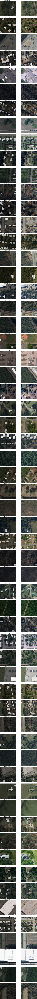

In [8]:

random.seed(30)

def visualize_random_samples(dataset, predictions, num_samples=40):
    # 랜덤하게 샘플 선택
    random_indices = random.sample(range(len(test_dataset)), num_samples)

    fig, axes = plt.subplots(num_samples, 2, figsize=(15, 5*num_samples))

    for i, idx in enumerate(random_indices): 
        # 원본 이미지
        image= dataset[idx]
        axes[i,0].imshow(image.permute(1, 2, 0))
        axes[i,0].set_title("Original & masking Image")
        axes[i,0].axis("off")

        # 예측된 마스크
        mask = predictions[idx]
        axes[i,0].imshow(mask, cmap="gray", alpha=0.5)
        axes[i,1].imshow(image.permute(1,2,0))
        axes[i,1].axis("off")
    plt.tight_layout()
    plt.show()

# 40개 이미지 선택 매개변수 입력
visualize_random_samples(test_visual, pred, num_samples=60)


In [12]:
submit = pd.read_csv('../data/sample_submission.csv')
submit['mask_rle'] = result

In [13]:
submit.to_csv('../submit/deepsplit_61218_exc71.csv', index=False)

  0%|          | 0/25 [00:00<?, ?it/s]

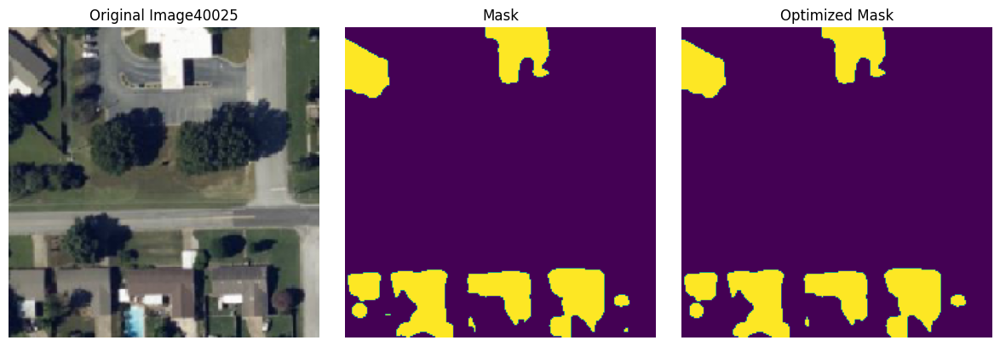

  4%|▍         | 1/25 [00:00<00:09,  2.65it/s]

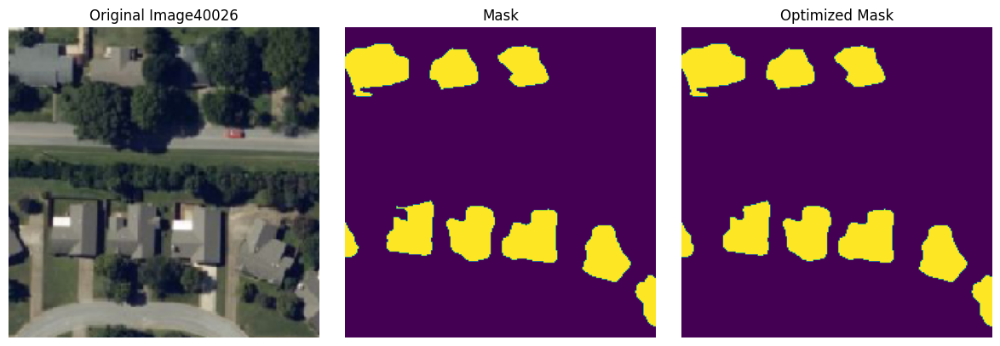

  8%|▊         | 2/25 [00:00<00:08,  2.60it/s]

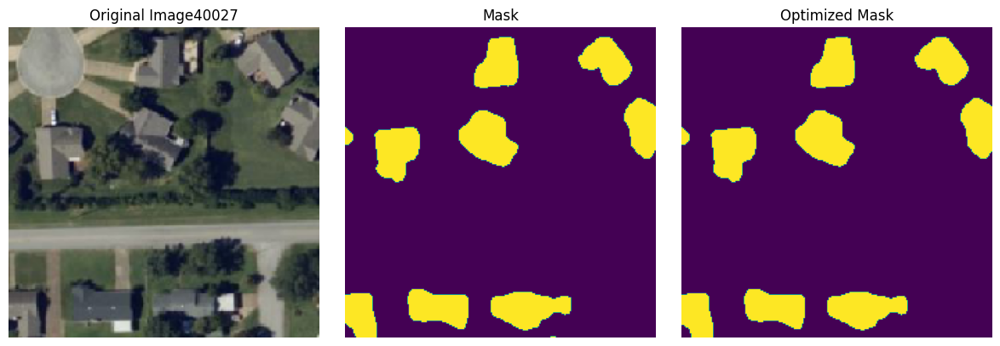

 12%|█▏        | 3/25 [00:01<00:08,  2.54it/s]

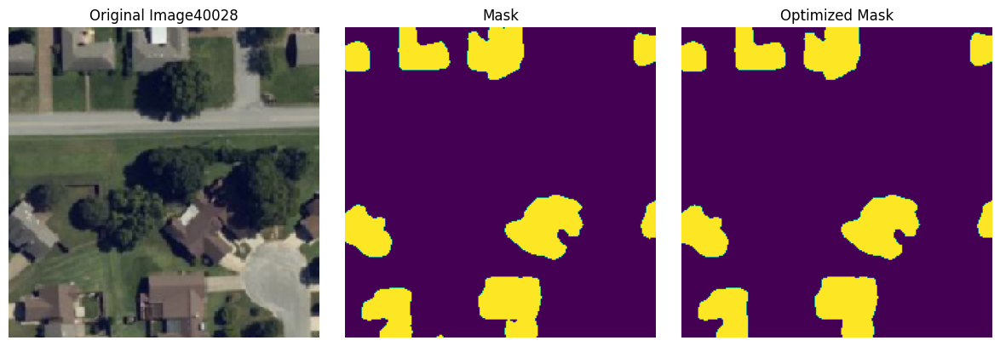

 16%|█▌        | 4/25 [00:01<00:08,  2.50it/s]

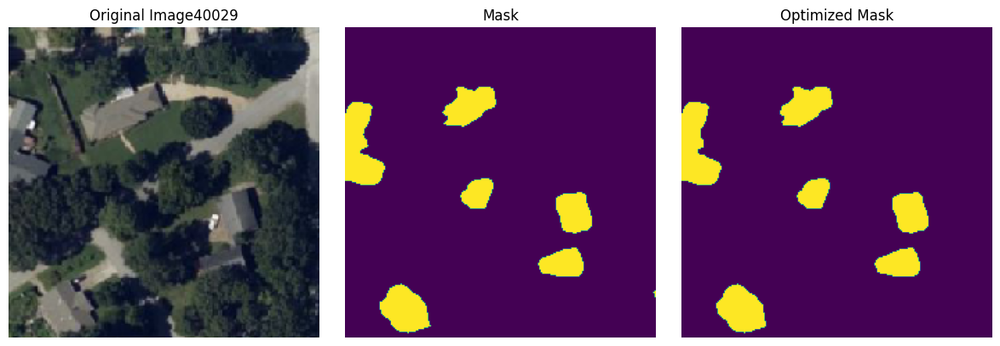

 20%|██        | 5/25 [00:01<00:07,  2.54it/s]

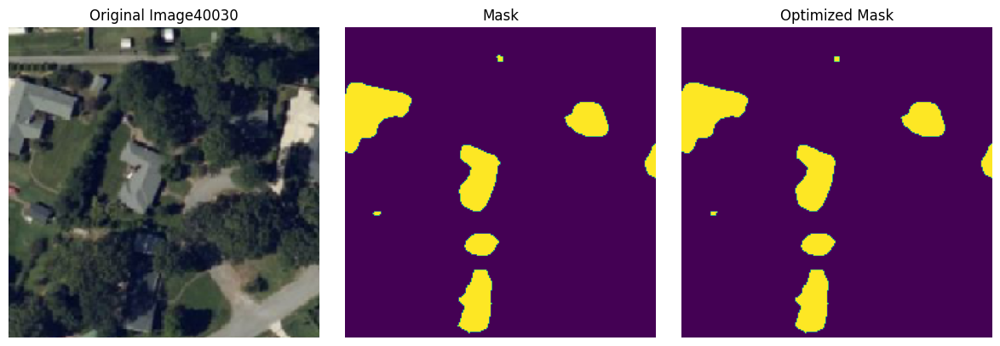

 24%|██▍       | 6/25 [00:02<00:07,  2.51it/s]

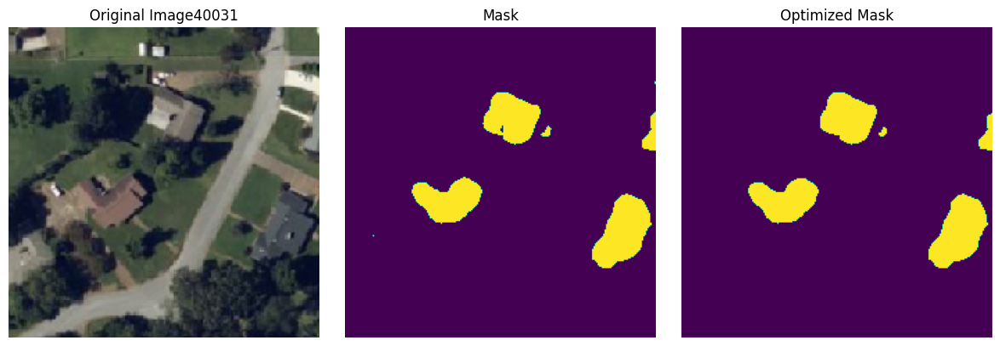

 28%|██▊       | 7/25 [00:02<00:07,  2.36it/s]

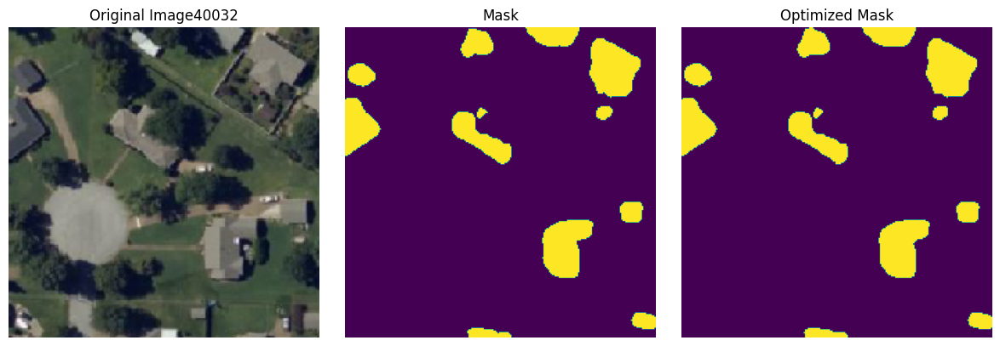

 32%|███▏      | 8/25 [00:03<00:07,  2.36it/s]

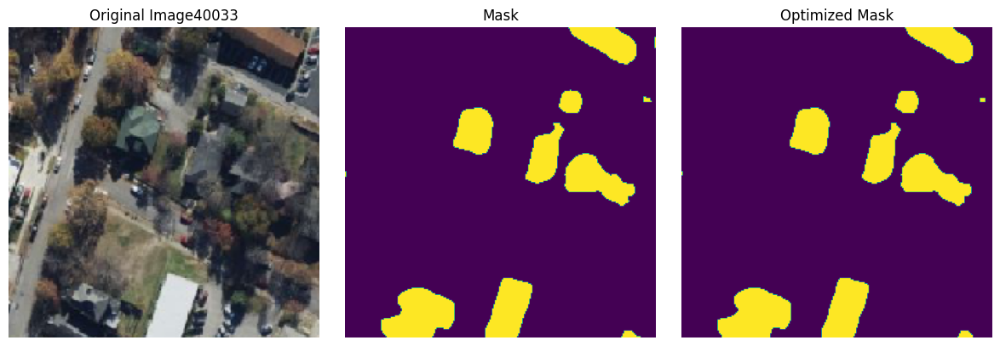

 36%|███▌      | 9/25 [00:03<00:07,  2.16it/s]

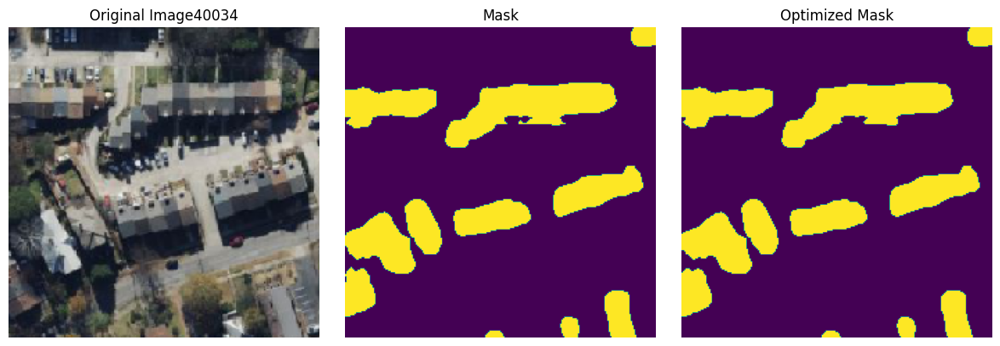

 40%|████      | 10/25 [00:04<00:06,  2.22it/s]

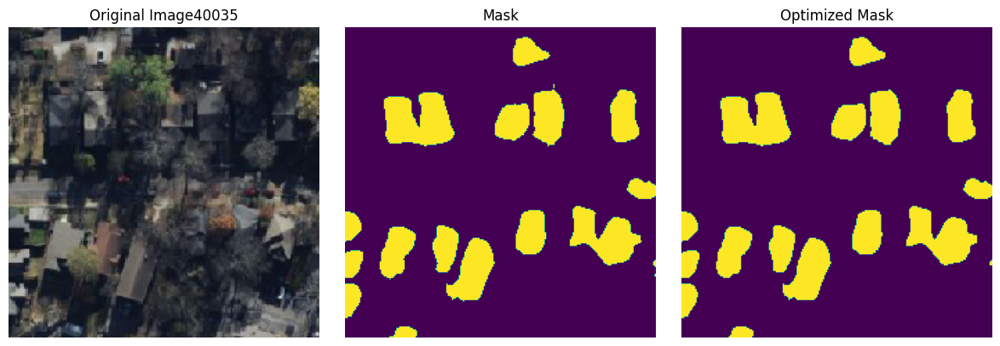

 44%|████▍     | 11/25 [00:04<00:05,  2.34it/s]

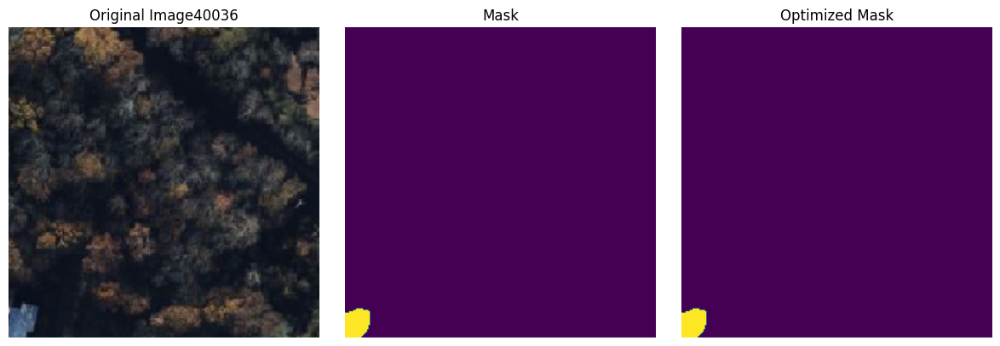

 48%|████▊     | 12/25 [00:04<00:05,  2.47it/s]

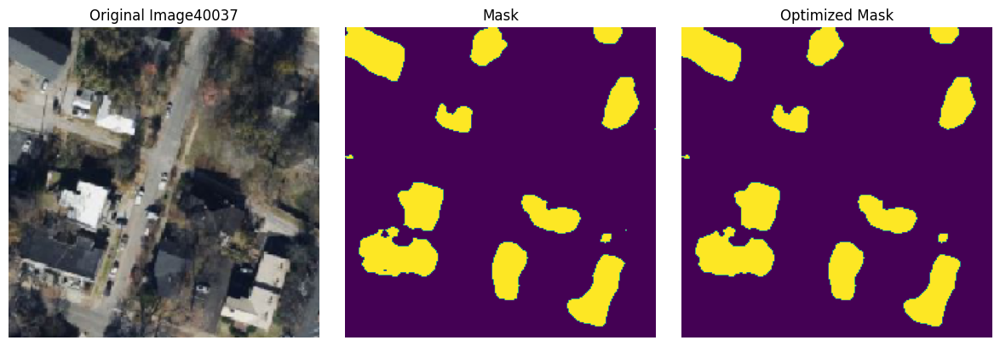

 52%|█████▏    | 13/25 [00:05<00:04,  2.50it/s]

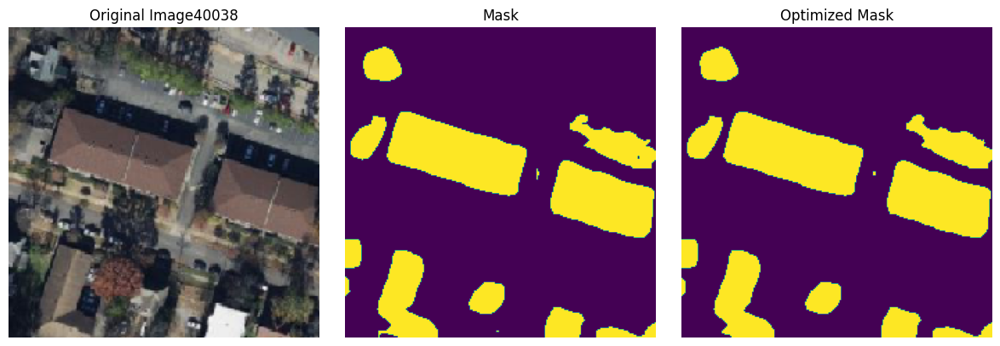

 56%|█████▌    | 14/25 [00:05<00:04,  2.46it/s]

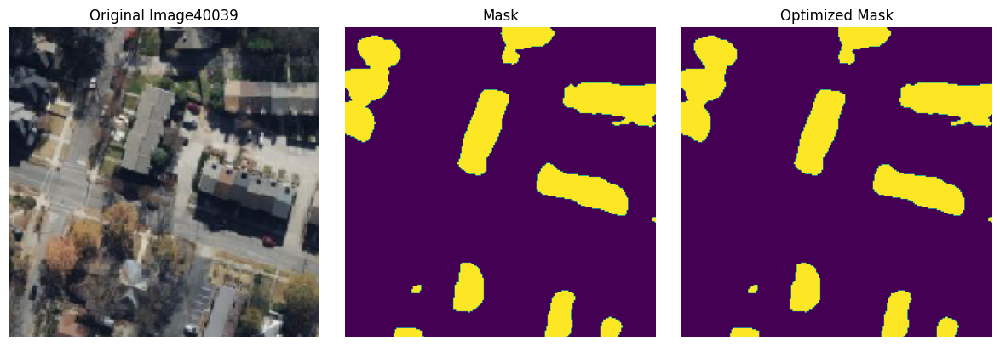

 60%|██████    | 15/25 [00:06<00:04,  2.47it/s]

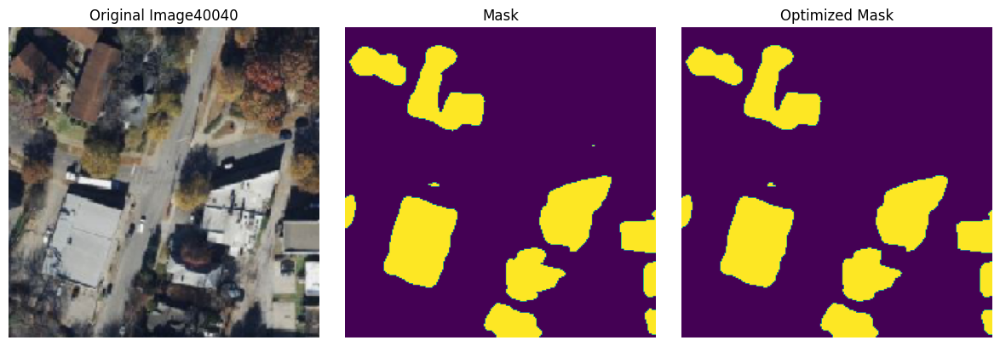

 64%|██████▍   | 16/25 [00:06<00:03,  2.46it/s]

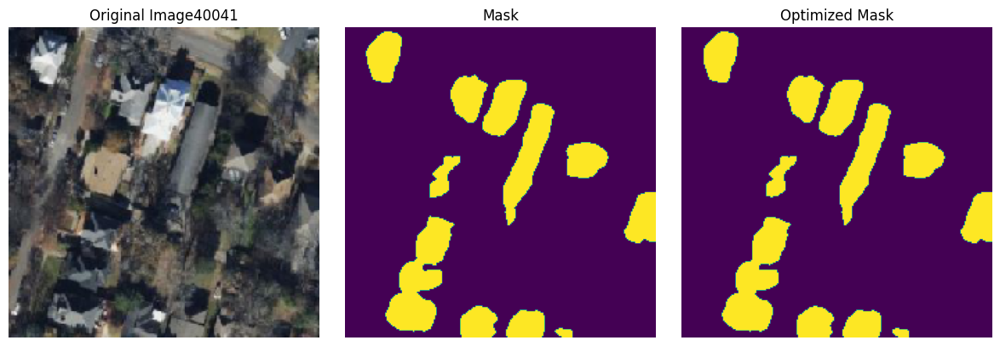

 68%|██████▊   | 17/25 [00:06<00:03,  2.53it/s]

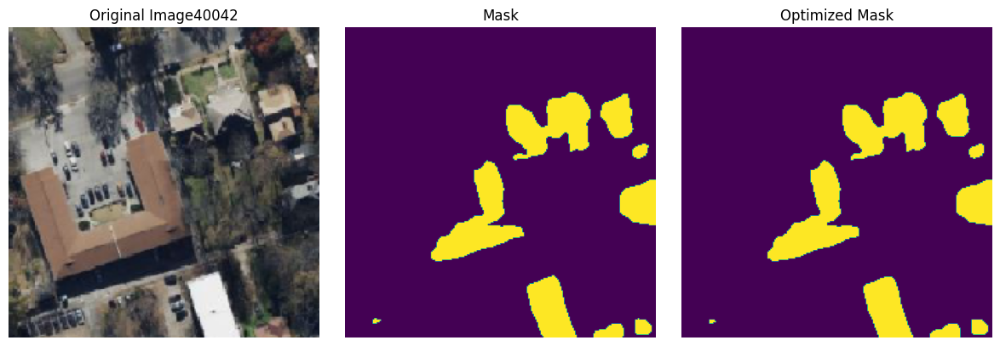

 72%|███████▏  | 18/25 [00:07<00:02,  2.62it/s]

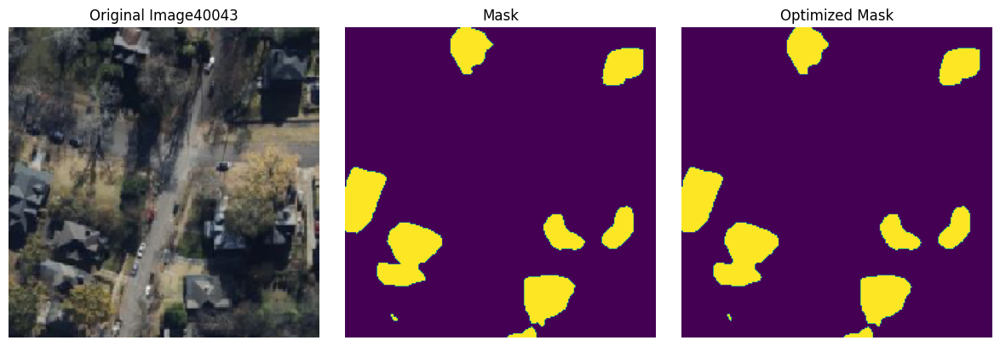

 76%|███████▌  | 19/25 [00:07<00:02,  2.60it/s]

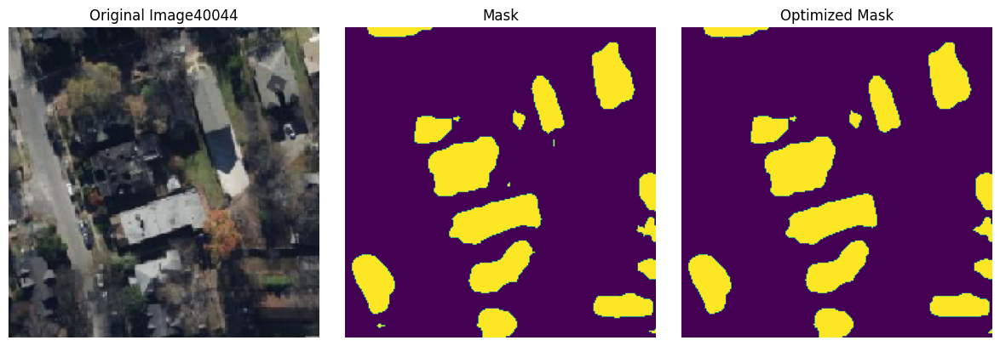

 80%|████████  | 20/25 [00:08<00:01,  2.57it/s]

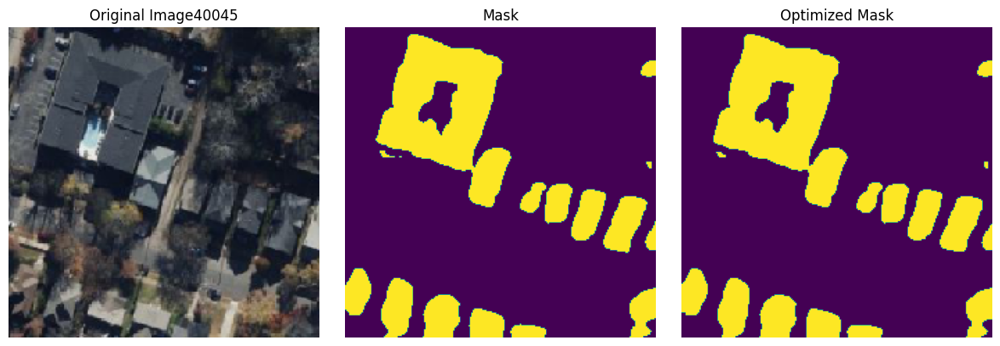

 84%|████████▍ | 21/25 [00:08<00:01,  2.63it/s]

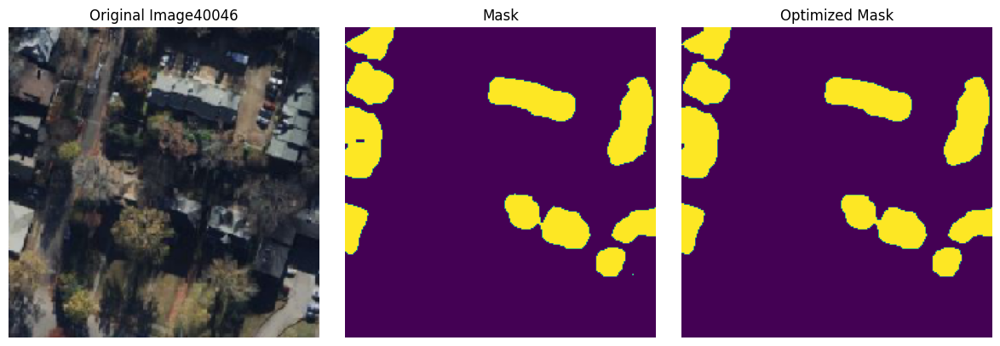

 88%|████████▊ | 22/25 [00:09<00:01,  2.28it/s]

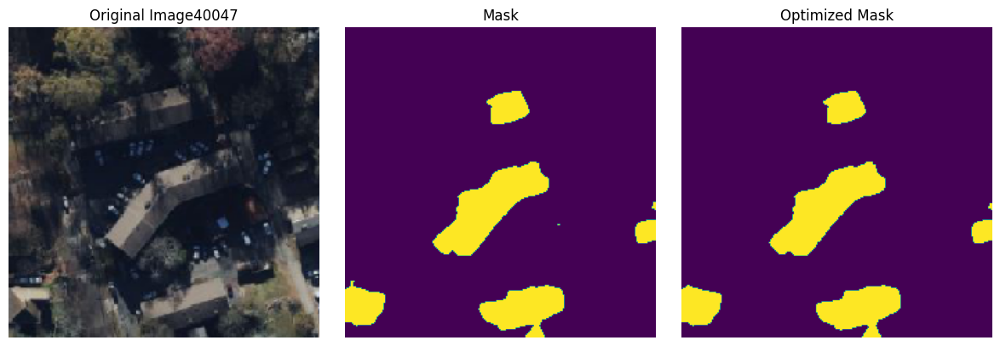

 92%|█████████▏| 23/25 [00:09<00:00,  2.37it/s]

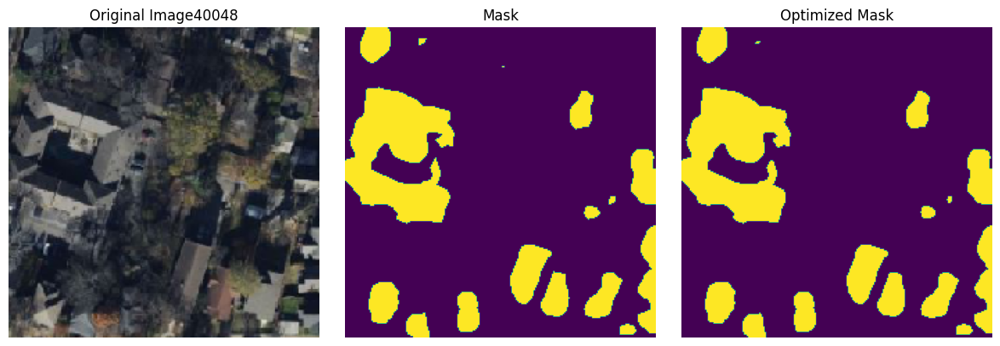

 96%|█████████▌| 24/25 [00:09<00:00,  2.43it/s]

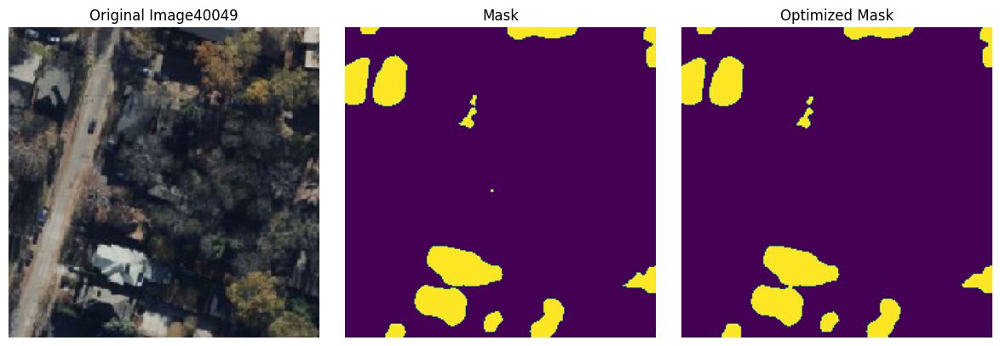

100%|██████████| 25/25 [00:10<00:00,  2.45it/s]

<bound method NDFrame.head of            img_id                                           mask_rle
40025  TEST_40025  102 44 326 44 550 44 774 45 998 45 1222 45 144...
40026  TEST_40026  2710 12 2932 15 3042 2 3153 19 3259 12 3368 28...
40027  TEST_40027  1680 9 1752 8 1898 17 1974 12 2121 18 2197 13 ...
40028  TEST_40028  40 12 105 24 264 12 329 24 488 13 552 25 712 1...
40029  TEST_40029  9714 5 9729 9 9937 8 9952 12 10161 12 10174 14...
40030  TEST_40030  4815 4 5039 4 5263 4 5487 4 8966 8 9188 13 941...
40031  TEST_40031  10638 9 10861 12 11084 15 11307 17 11531 19 11...
40032  TEST_40032  93 3 131 39 314 7 356 38 538 9 580 38 761 13 8...
40033  TEST_40033  162 35 387 35 611 36 836 36 1060 38 1285 39 15...
40034  TEST_40034  209 16 432 17 656 17 879 18 1103 18 1327 18 15...
40035  TEST_40035  1697 4 1917 10 2140 12 2364 13 2588 14 2812 14...
40036  TEST_40036  45481 5 45703 11 45924 15 46145 18 46369 18 46...
40037  TEST_40037  1 16 102 10 180 20 225 16 325 11 404 21 449 18...
4003

In [18]:
# CSV 파일 로드
csv_file = pd.read_csv('../submit/submit_deepsplit160.csv')  # CSV 파일 경로
result_data = pd.DataFrame(columns=['img_id', 'mask_rle'])

image = cv2.imread(f'../data/test_img/{csv_file["img_id"][0]}.png')

d = dcrf.DenseCRF2D(224, 224, 2)  # width, height, nlabels
d.addPairwiseGaussian(sxy=1, compat=3)
d.addPairwiseBilateral(sxy=2, srgb=2, rgbim=image, compat=2)


# 각 사진과 마스크에 대해 예시 출력
for i in tqdm(range(0, 40050)):
    # 사진 파일 경로 생성
    image_path = f'../data/test_img/{csv_file["img_id"][i]}.png'  # 이미지 파일 경로 생성
    # 사진 파일 확인
    try:
        image = cv2.imread(image_path)
        if image is None:
            raise FileNotFoundError(f"Image file not found: {image_path}")
    except Exception as e:
        print(str(e))
        continue

    # 마스크 정보 로드 및 디코딩
    mask_data = csv_file['mask_rle'][i]
    mask = rle_decode(mask_data, image.shape[:2])

    
    # 이미지에 마스크 적용
    # masked_image = cv2.bitwise_and(image, image, mask=mask)

    # DenseCRF2D 입력 설정

    ############## 재욱이 추가 부분 ##################
    unary = np.stack((mask, 1 - mask), axis=0).reshape(2, -1).astype(np.float32)
    # unary potential 설정
    d.setUnaryEnergy(unary)

    # DenseCRF2D 수행
    Q = d.inference(10)  # 반복 횟수 설정

    # 최적화된 마스크 가져오기
    result_mask = np.argmax(Q, axis=0).reshape((224, 224))

    # 결과 이미지들을 리스트에 추가
    

    ############## 재욱이 추가 부분 끝 ################## (밑에는 출력)

    # 결과를 DataFrame에 저장
    result_data.loc[i] = [csv_file['img_id'][i], rle_encode(result_mask)]

    # 결과 이미지 출력
    result_images = [image, mask, result_mask]
    fig, axes = plt.subplots(1, 3, figsize=(12, 4))
    titles = ['Original Image' + str(i), 'Mask', 'Optimized Mask']
    for ax, img, title in zip(axes, result_images, titles):
        if len(img.shape) == 3: 
            img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        ax.imshow(img)
        ax.set_title(title)
        ax.axis('off')
    plt.tight_layout()
    plt.show()

# 결과 DataFrame을 final.csv 파일로 저장
    result_data['mask_rle'] = result_data['mask_rle'].fillna(-1)
print(result_data.head)
result_data.to_csv('../submit/submit_deepsplit_post1.csv', index=False)